# exp16_SuperResolution : mini project

>author : bae hueng myoung<br>
>date : 25 nov 2021<br>

## [1] SuperResolution by "Bicubic interpolation"

In [141]:
import cv2
from skimage import data
import matplotlib.pyplot as plt

# 다운받은 파일의 경로를 설정해 주세요.
gif = cv2.VideoCapture("metro_lr.gif")

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 35
frame 크기 : (252, 282, 3)


In [142]:
resized_frames = []
for frame in frames:
    resized_frames.append(cv2.resize(frame, dsize=(150,100)))
len(resized_frames[0].shape)

3

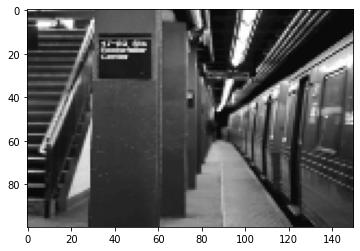

In [143]:
plt.imshow(resized_frames[0])
plt.show()

In [144]:
frame_height, frame_width, _ = resized_frames[0].shape
frame_height

100

In [145]:
def Bicubic(frame,frame_height,frame_width):
    bicubic_image = cv2.resize(
    frame, 
    dsize=(frame_width*4, frame_height*4), # (가로 픽셀 수, 세로 픽셀 수)
    interpolation=cv2.INTER_CUBIC) # bicubic interpolation 적용
    return bicubic_image

In [146]:
Bic_frames = []
for frame in resized_frames:
    Bic_frames.append(Bicubic(frame,frame_height, frame_width))

Bic_frames[0].shape

(400, 600, 3)

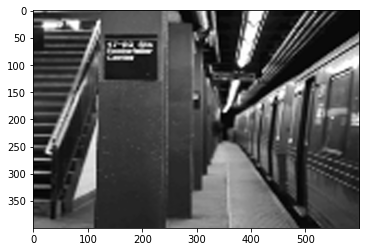

In [147]:
plt.imshow(Bic_frames[0])
plt.show()

In [148]:
frame_height, frame_width,_ = Bic_frames[0].shape

In [149]:
frame_height

400

#### result : Bicubic interpolation으로 width, height각각 4배씩 늘린 결과를 보여준다

## [2] SuperResolution by applying "SRGAN"

### SRGAN TEST

In [150]:
import tensorflow as tf
import os

model_file = os.getenv('HOME')+'/aiffel/exp16_SuperResolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [151]:
import numpy as np

def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

In [154]:
sr_frames = []
for img in resized_frames:
    lr_tensor_img = tf.convert_to_tensor(img, np.float32)
    sr_frames.append(apply_srgan(lr_tensor_img))

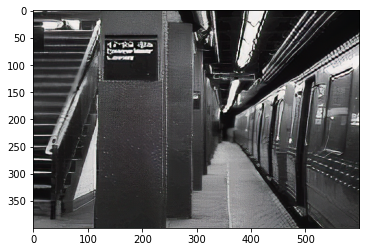

In [155]:
plt.imshow(sr_frames[0])
plt.show()

In [156]:
import imageio

imageio.mimsave("bicubic_interpolation.gif", Bic_frames)
imageio.mimsave("srgan.gif", sr_frames)

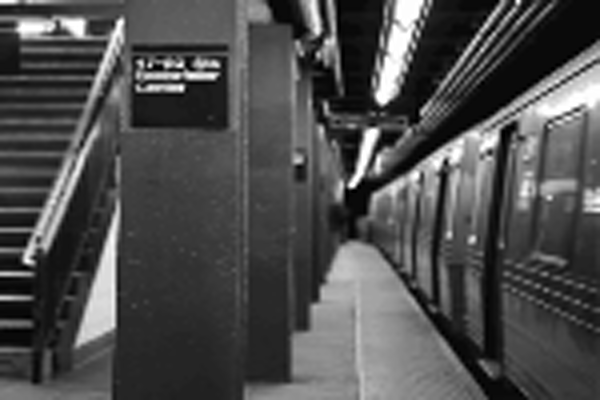

In [157]:
from IPython.display import Image as show_gif

show_gif("bicubic_interpolation.gif", width=500) # width 는 적당히 큰 값으로 설정해주세요

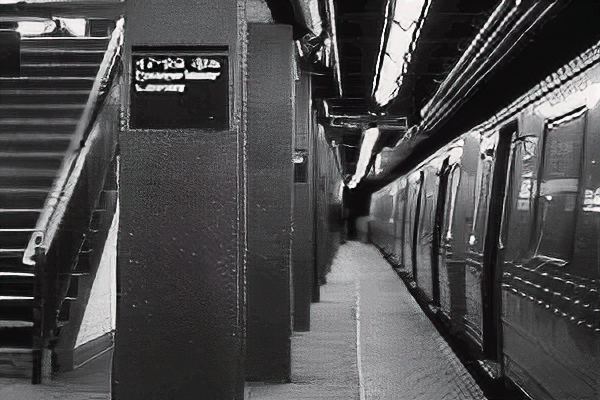

In [158]:
show_gif("srgan.gif", width=500) 

## analysis : 

interpolation과 SRGAN의 4배 화질의 super resolution의 결과는 위와 보이는 것과 같이 매우 큰 화질의 차이를 보인다. interpolation은 srgan보다 훨씬 부자연스러우며 선명하지 않는 모습을 보인다. 반면 srgan은 원본 gif와 비교하여 볼 때 4배의 크기가 확장되었음에도 불구하고 화질의 선명도 차이는 크게 나타나보이지 않는다. 이러한 성능 차이는 메커니즘의 차이에서 비롯된다. bicubic은 인접한 16개의 포인트의 값을 토대로 픽셀값을 정한다. 이러한 것은 이미지의 급변하는 구간에서 선명도를 보장할 수 없다. 반면 SRGAN은 GAN의 학습된 생성된 이미지를 토대로 더욱 세분화된 이미지의 결과를 보여준다. 

고화질의 이미지를 얻는 것은 의료계에서 환영받는 기술일 것이다. 하지만 SRGAN의 우수한 super resolution에도 불구하고 실제 이미지와 분명한 차이를 보이는 것은 사실이다. GAN은 새로운 비슷한 이미지를 생성하는 기술이며 매우 세심하고 중요하게 다뤄야 할 의료 데이터에서 활용될 수 있을지 의문스럽다. 하지만 이번 프로젝트의 의의는 매우 섬세하고 판별 위험성이 적은 분야에서 하드웨어의 비용을 지불하지 않고도 super resolution의 의미지를 얻을 수 있는 소프트웨어적인 방법의 옵션을 활용할 수 있다는 점에서 매우 큰 의의가 있다.